# Introduction
Here, I perform an unbiased visualization of the mRNA data. I correct only for batch at this point. Through some exploratory analysis, we've seen a prominent effect due to mitochondrial transcripts that can't be corrected by simply remove the genes from the matrix. For now, we are planning on generating a _clean_ dataset without any of the contaminating cells.

# Setup

In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from scipy import sparse
import warnings
import itertools as it
import json
import seaborn as sns
import pickle as pkl
from functools import reduce
import gc
import timeit

from nero import Octavia
from nero import Nero as nr

In [2]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)
sc.settings.n_jobs=30

In [3]:
mountpoint = '/data/clue/'
prefix_adts = mountpoint + 'prod/adts/'
prefix_mrna = mountpoint + 'prod/mrna/'
prefix_comb = mountpoint + 'prod/comb/'

In [4]:
Octavia.set_mountpoint(mountpoint)

## Load in Data

In [5]:
path = prefix_mrna + 'pkls/wells_sng_covars.pkl'

# with open(path,'wb') as file:
#     pkl.dump(wells, file)
    
with open(path,'rb') as file:
    wells = pkl.load(file)

### Adjust Cell Barcodes, Filter

I'm adjusting the cell barcodes to make them match their well number, which I also did with the ADTs.

In [6]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

# Processing

In [7]:
concat = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])

In [8]:
concat.var['total_mrna_n_counts'] = concat.X.toarray().sum(axis=0)
concat.obs['mrna_n_counts'] = concat.X.toarray().sum(axis=1)

In [9]:
path = prefix_mrna + 'vals/mito.csv'
obs = pd.read_csv(path, index_col=0)
obs = obs[(obs['ct1'] == 'LOW_MITO') & (obs['ct2'] == 'NORMAL')].index.values

In [10]:
concat = concat[obs].copy()
concat.var['subsetted_mrna_n_counts'] = concat.X.toarray().sum(axis=0)

In [11]:
concat.shape

(136142, 20603)

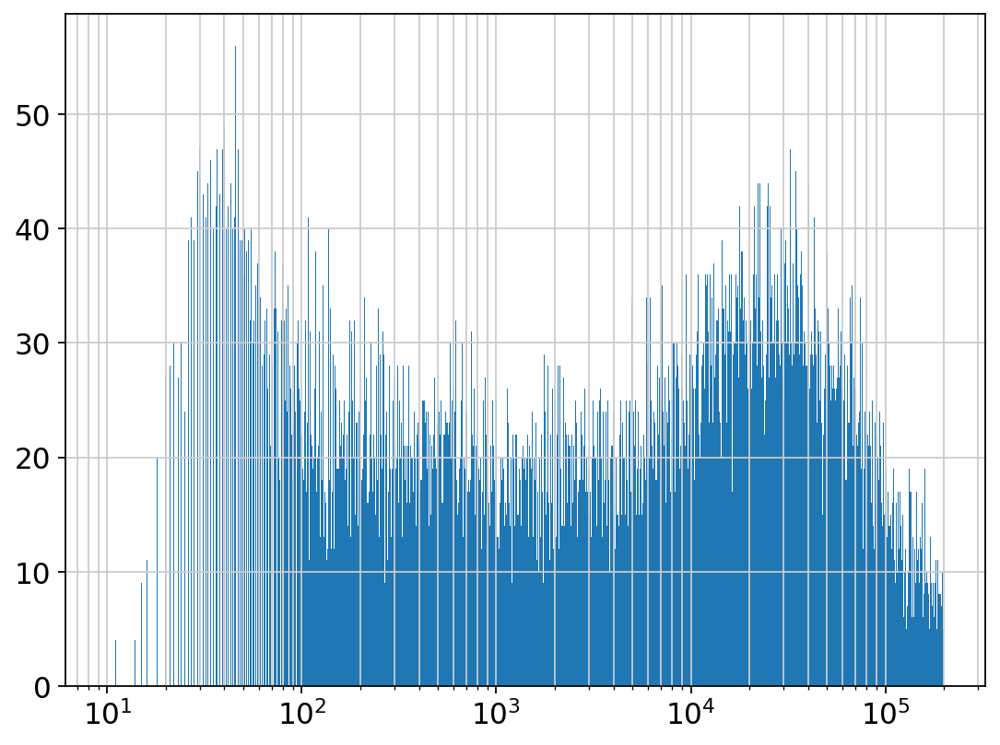

In [13]:
plt.figure(figsize=(8,6))
plt.hist(concat.var['total_mrna_n_counts'].values, bins=np.logspace(np.log10(10),np.log10(2e5), 1000))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [13]:
sc.pp.filter_genes(concat, min_counts=100, inplace=True) # keep as many genes as possible
sc.pp.normalize_per_cell(concat, counts_per_cell_after=1e6)
sc.pp.log1p(concat)
sc.pp.scale(concat)
sc.pp.combat(concat, key='batch',covariates=['cond', 'free_id'])
sc.pp.scale(concat)
sc.pp.pca(concat, n_comps=200)

filtered out 3153 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 200
    finished (0:08:02)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


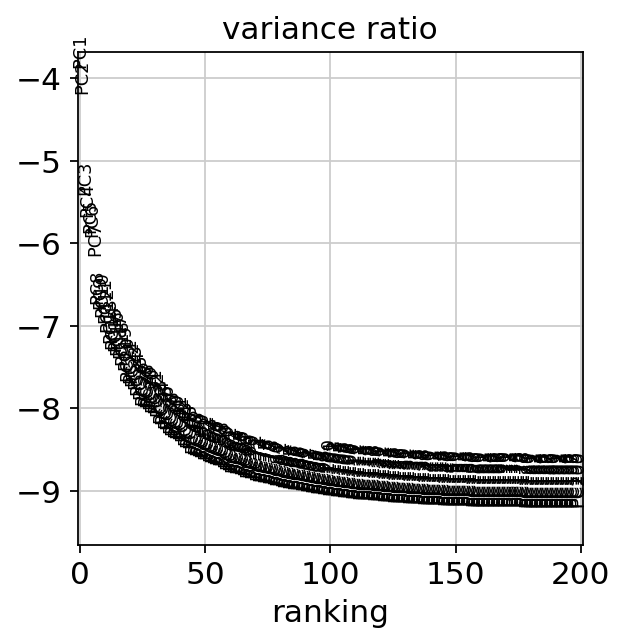

In [16]:
sc.pl.pca_variance_ratio(concat, log=True, n_pcs=200)

In [17]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(concat, n_neighbors=15, n_pcs=150, random_state=0)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 150
    computed neighbors (0:01:39)
    computed connectivities (0:00:05)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:01:45)


In [18]:
sc.tl.umap(concat, random_state=0)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:09)


In [56]:
sc.tl.leiden(concat, resolution=0.5, random_state=0)

running Leiden clustering
    finished: found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:25)


# Initial Visualization

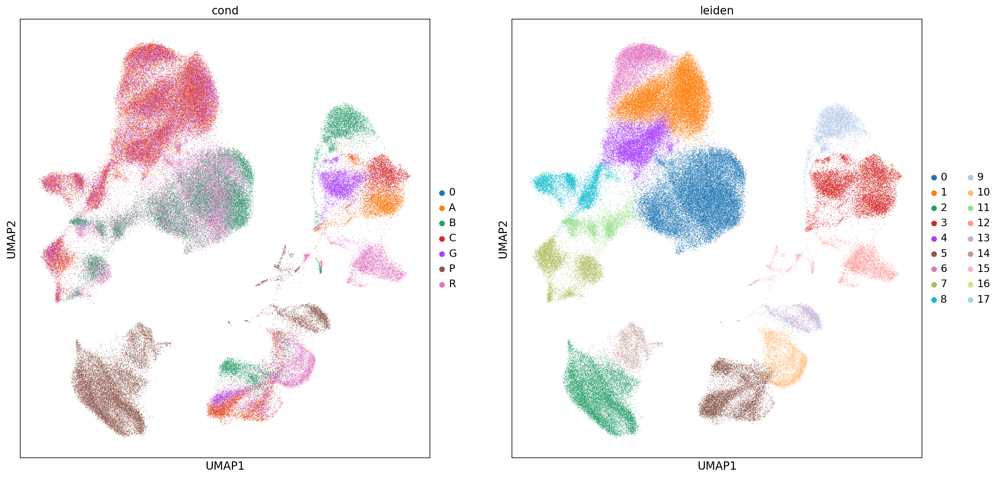

In [57]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [sc.pl.palettes.default_20, sc.pl.palettes.default_20]):
    sc.pl.umap(concat, color=color, ax=ax, show=False, return_fig=False, size=2, palette=palette)

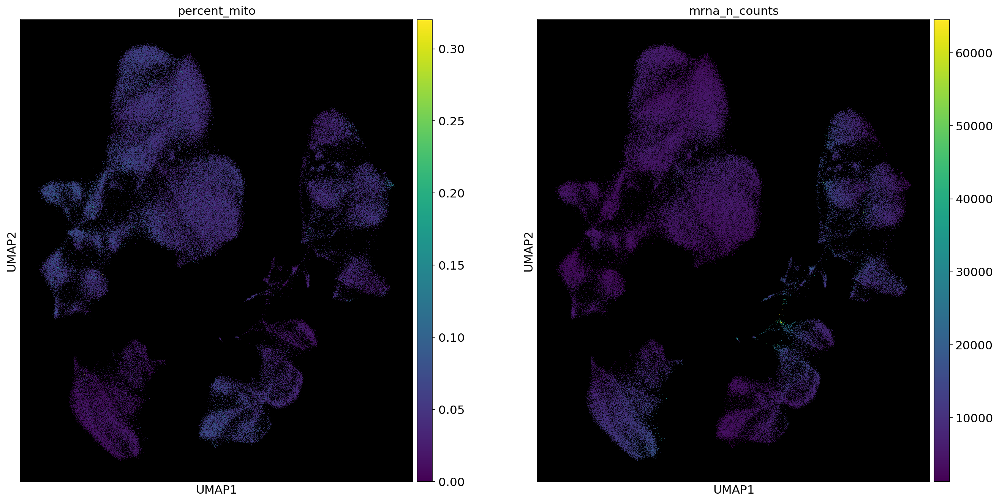

In [21]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['percent_mito', 'mrna_n_counts'], ax):
    ax.set_facecolor('black')
    sc.pl.umap(concat,color=color, ax=ax, show=False, return_fig=False, size=2)

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


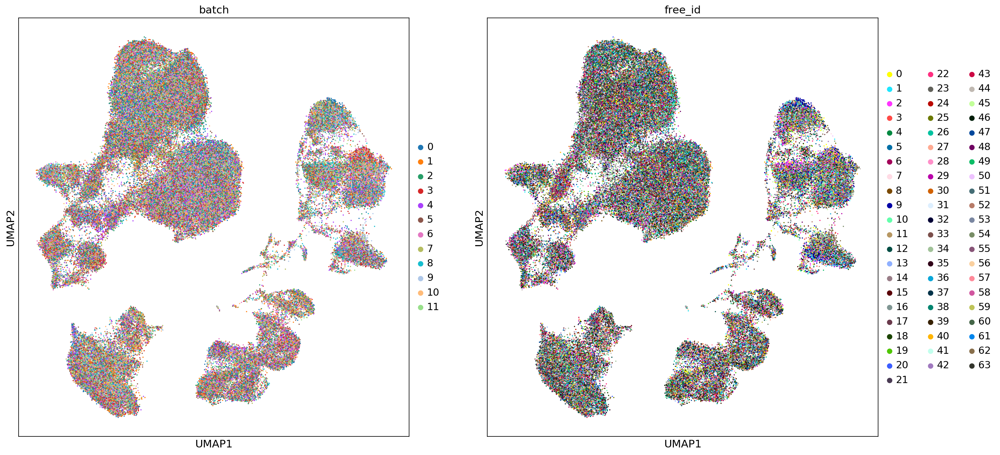

In [22]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['batch', 'free_id'], ax):
    sc.pl.umap(concat[np.random.choice(concat.obs_names.values, replace=False, size=len(concat.obs_names.values)),:],
               color=color, ax=ax, show=False, return_fig=False, size=10)

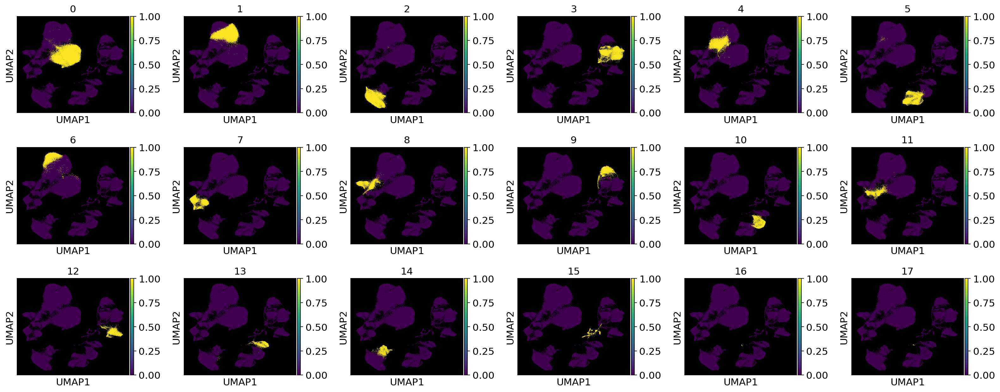

In [23]:
fig, ax = plt.subplots(3,6,figsize=(20,10))
for val, ax in tqdm(zip(concat.obs['leiden'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['leiden'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

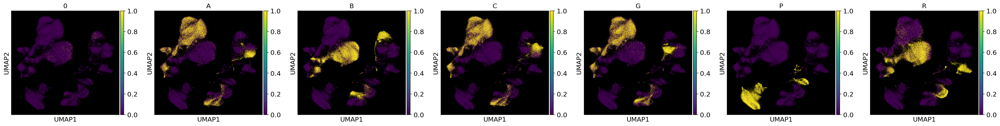

In [24]:
fig, ax = plt.subplots(1,7, figsize=(30,4))
for val, ax in tqdm(zip(concat.obs['cond'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['cond'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

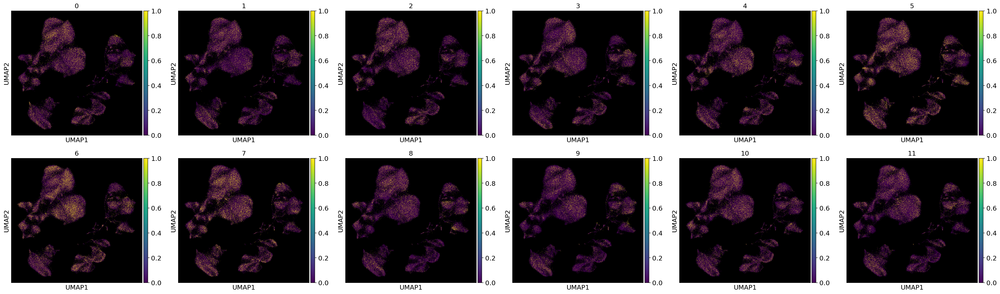

In [31]:
fig, ax = plt.subplots(2,6, figsize=(30,9))
for val, ax in tqdm(zip(concat.obs['batch'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['batch'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

# Add Raw Data

In [14]:
raw_mrna = Octavia.get_raw_mrna(concat.obs_names).copy()

In [15]:
raw_adts = Octavia.get_raw_adts(concat.obs_names).copy()

In [16]:
raw = raw_mrna.T.concatenate(raw_adts.T).T
raw.var_names = [i[:-2] for i in raw.var_names]

In [17]:
concat.raw = raw

# Export

In [ ]:
path = prefix_comb + 'h5ads/concat_2.h5ad'

# concat.write_h5ad(path)
concat = sc.read_h5ad(path)

# Visualize Features

In [7]:
proteins = [i for i in concat.raw.var_names if '|' in i]
transcripts = [i for i in concat.raw.var_names if '|' not in i]
all_features = proteins + transcripts

In [8]:
features = ['CD3E', 'CD3|CD3E', 'CD4|CD4', 'CD4', 'CD8|CD8A', 'CD8A', 
            'CD56|NCAM1', 'NCAM1', 'CD14|CD14', 'CD14', 'CD16|FCGR3A','FCGR3A',
            'CD20|MS4A1', 'MS4A1', 'CD19', 'CD226|CD226', 'CD226', 'CD235a_b|GYPA_GYPB',
            'CLEC4C', 'CD123|IL3RA', 'CD103|ITGAE', 'ITGAE', 'MZB1', 'JCHAIN'
           ]

0it [00:00, ?it/s]

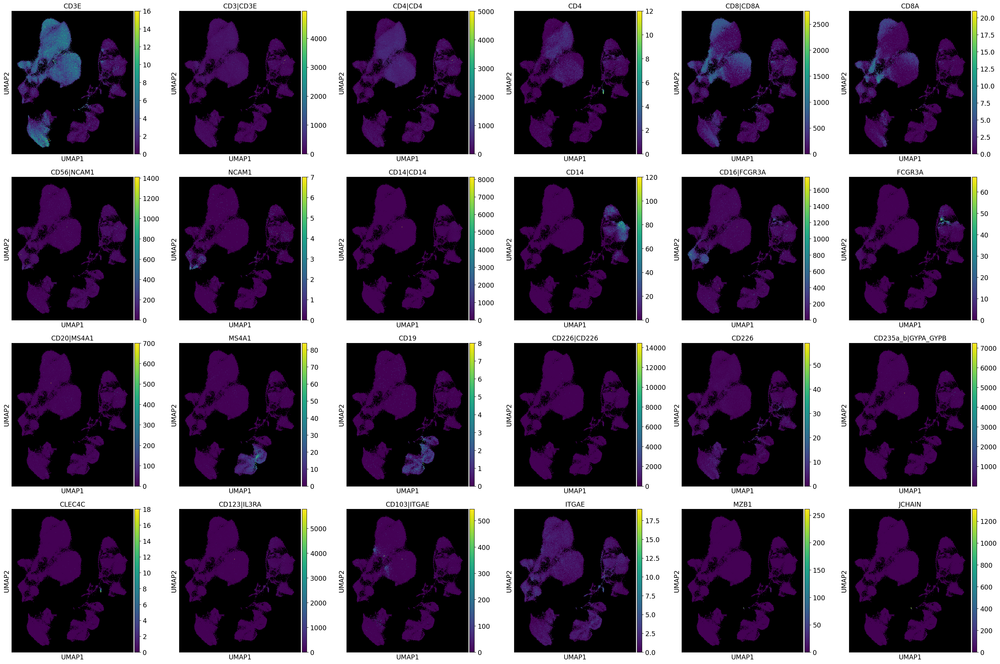

In [9]:
fig, ax = plt.subplots(4, 6, figsize=(30, 20))
for ax, f in tqdm(zip(np.ravel(ax), features)):
    ax.set_facecolor('black')
    sc.pl.umap(concat, color=f, ax=ax, show=False, return_fig=False, size=5, use_raw=True)
plt.tight_layout()

In [7]:
original_leiden = concat.obs['leiden'].copy()
# concat.obs['leiden'] = original_leiden

In [8]:
features = ['CD14|CD14', 'CD14', 'CD16|FCGR3A','FCGR3A', 'LYZ', 'S100A8',
            'S100A10', 'HLA-ABC|HLA-A_B_C', 'HLA-DRA', 'CD74', 'IFI30', 'HLA-DPB1',
            'CD2|CD2', 'CLEC10A', 'FCER1A', 'CD11c|ITGAX', 'ITGAX', 'CD11b|ITGAM',
           ]

0it [00:00, ?it/s]

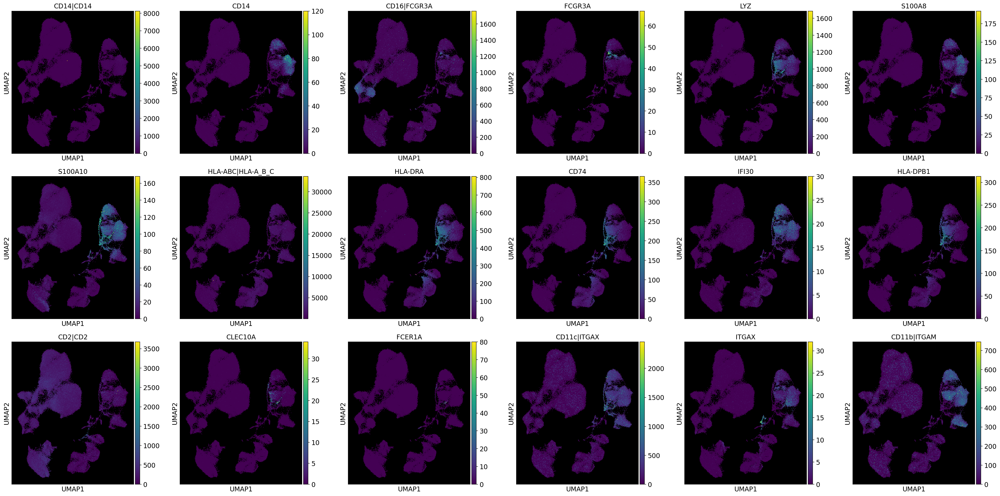

In [16]:
fig, ax = plt.subplots(3, 6, figsize=(30, 15))
for ax, f in tqdm(zip(np.ravel(ax), features)):
    ax.set_facecolor('black')
    sc.pl.umap(concat, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=True)
plt.tight_layout()

So it looks like the big population, for each of C, G, B and A conditions, are the classical monocytes, and then there are those very small populations that are CD16+ that are clustering together. R has it's own set of those clustered totally away from the others, while the P cells are almost all depleted. And then, there are ofcourse those cells that are stretching from each classical monocyte population towards the central cluster that seems to be bright for CD11c protein and CD74 transcript, but has lost many of the other markers. Based on those markers, as well as expression of CLEC10A and FCER1A and the way they stretch from the classical monocyte population (which I've seen in other datasets of PBMCs), I believe those to be conventional dendritic cells. I think the ones that are defining the trajectory from each classical monocyte cluster to the common cluster are cDC2s and the ones forming the common cluster are cDC1s.

As a side note now, I'm now wondering if PMA/I induced the differentiation of the monocytes to macrophages that were adherent and therefore did not get withdrawn from the culture plates. Perhaps can explore evidence of that in the gene expression.

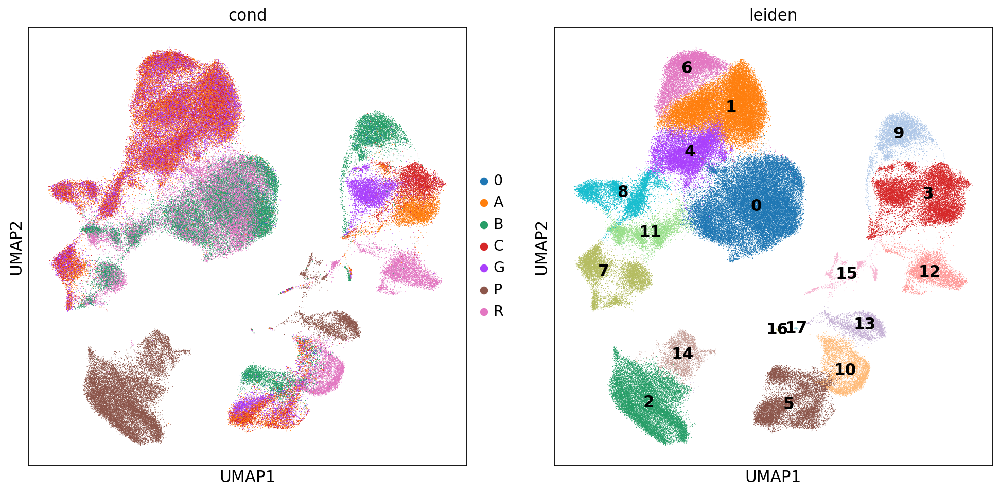

In [17]:
fig, ax = plt.subplots(1, 2, figsize=(15,7))
for color, ax, loc in zip(['cond', 'leiden'], ax, ['right margin', 'on data']):
    sc.pl.umap(concat,color=color, ax=ax, show=False, return_fig=False, size=2, legend_loc=loc)

# Grouping and Subclustering

In [10]:
clusts = [0, 2, 3, 5, 9, 10, 12, 13, 14, 15]

In [11]:
sub_concat = dict() # put the new subsetted adata objects in a dictionary of concat
for clust in clusts:
    sub_concat[str(clust)] = concat[concat.obs['leiden'] == str(clust)].copy()

In [16]:
sc.tl.leiden(sub_concat['0'], resolution=0.3, random_state=0) # subcluster them using Leiden
groupings = [[0, 2]
             ]
nr.regroup(sub_concat['0'], groupings, key='leiden')
sc.pl.umap(sub_concat['0'], color='leiden', size=5)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


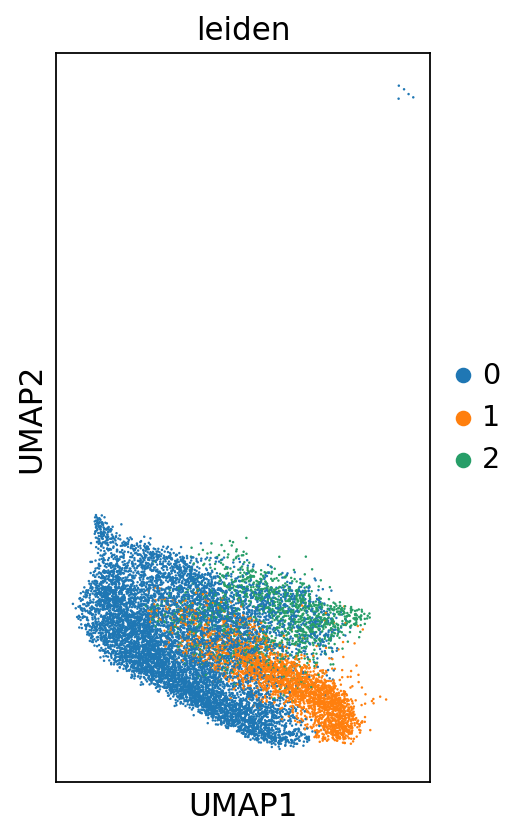

In [17]:
sc.tl.leiden(sub_concat['2'], resolution=0.2, random_state=0) # subcluster them using Leiden

fig, ax = plt.subplots(1,1,figsize=(3,6))
sc.pl.umap(sub_concat['2'], color='leiden', size=5, ax=ax);

running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


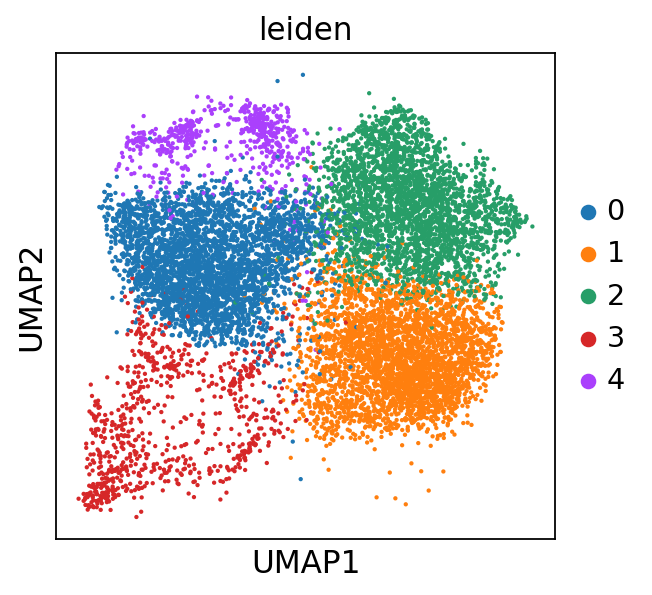

In [18]:
sc.tl.leiden(sub_concat['3'], resolution=0.3, random_state=0) # subcluster them using Leiden
sc.pl.umap(sub_concat['3'], color='leiden', size=15)

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)
New number of clusters: 2


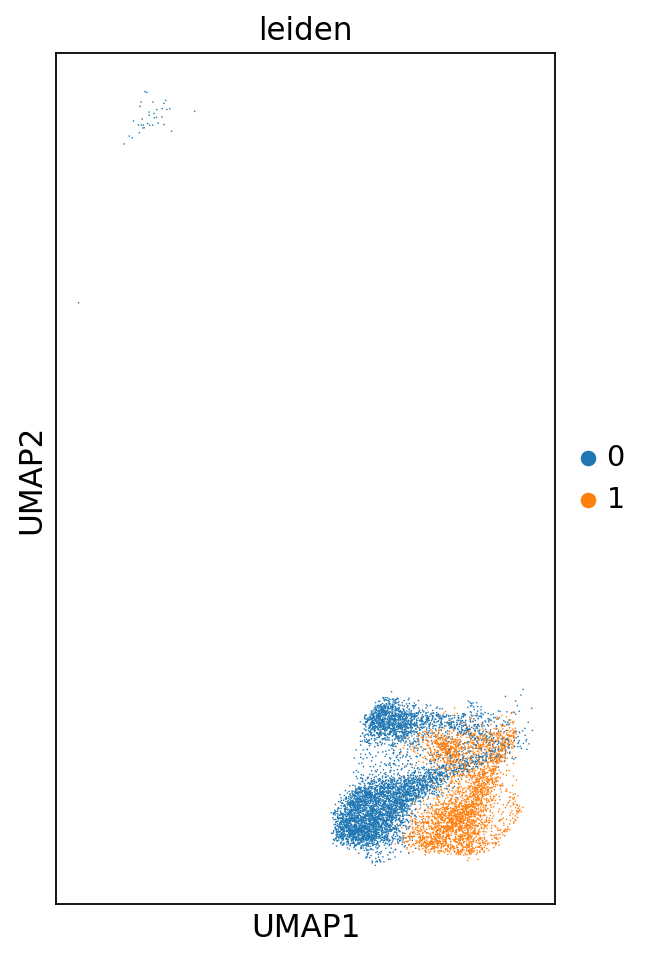

In [20]:
sc.tl.leiden(sub_concat['5'], resolution=0.4, random_state=0) # subcluster them using Leiden
groupings = [[0, 2, 3, 5, 6],
             [1, 4]
             ]
nr.regroup(sub_concat['5'], groupings=groupings)
fig, ax = plt.subplots(1,1,figsize=(4,7))
sc.pl.umap(sub_concat['5'], color='leiden', size=2, ax=ax)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


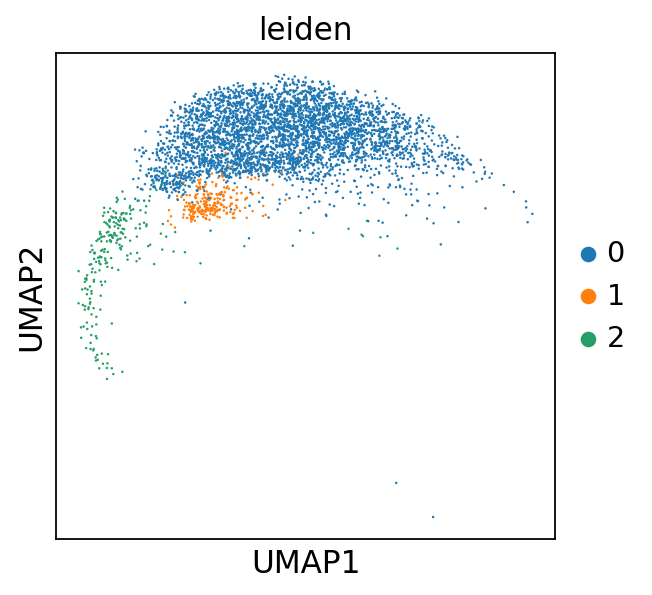

In [21]:
sc.tl.leiden(sub_concat['9'], resolution=0.15, random_state=0) # subcluster them using Leiden
sc.pl.umap(sub_concat['9'], color='leiden', size=5)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


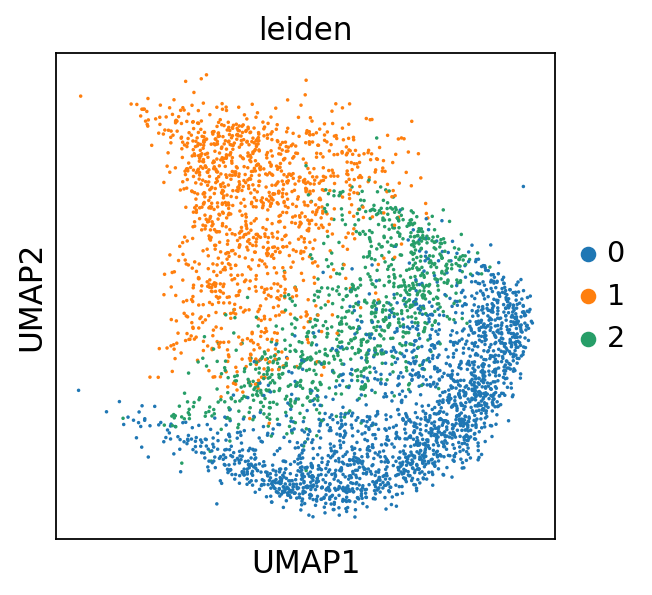

In [22]:
sc.tl.leiden(sub_concat['10'], resolution=0.2, random_state=0) # subcluster them using Leiden
sc.pl.umap(sub_concat['10'], color='leiden', size=10)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


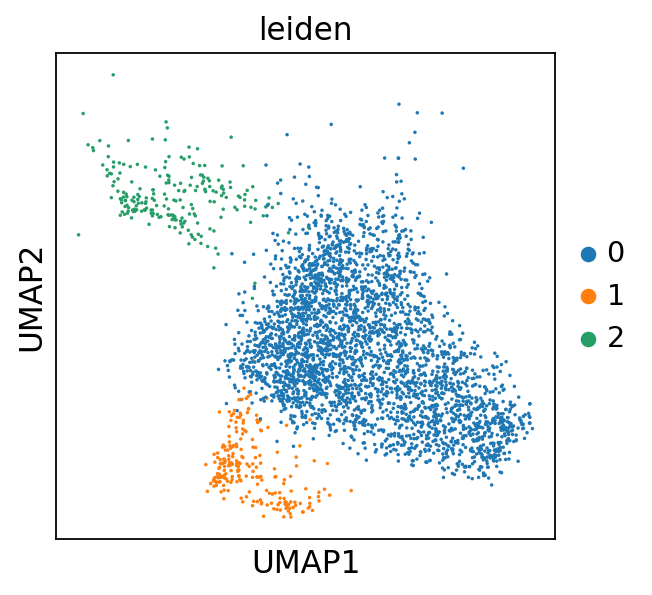

In [23]:
sc.tl.leiden(sub_concat['12'], resolution=0.15, random_state=0) # subcluster them using Leiden
sc.pl.umap(sub_concat['12'], color='leiden', size=10)

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


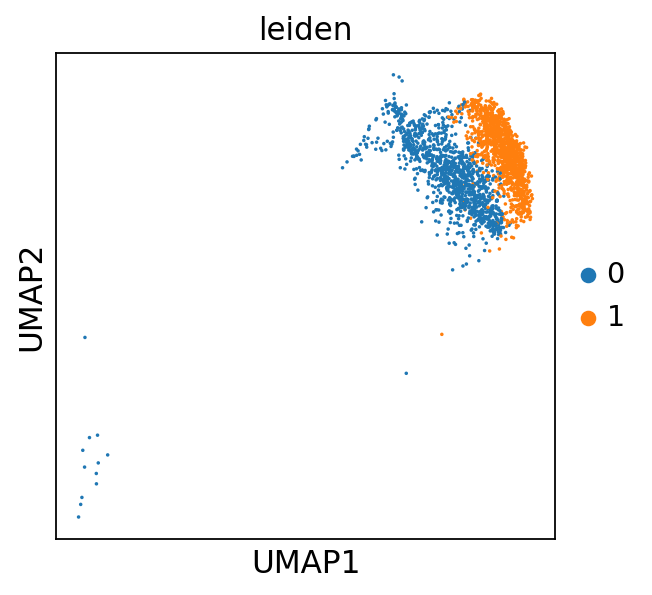

In [24]:
sc.tl.leiden(sub_concat['13'], resolution=0.15, random_state=0) # subcluster them using Leiden
sc.pl.umap(sub_concat['13'], color='leiden', size=10)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
New number of clusters: 2


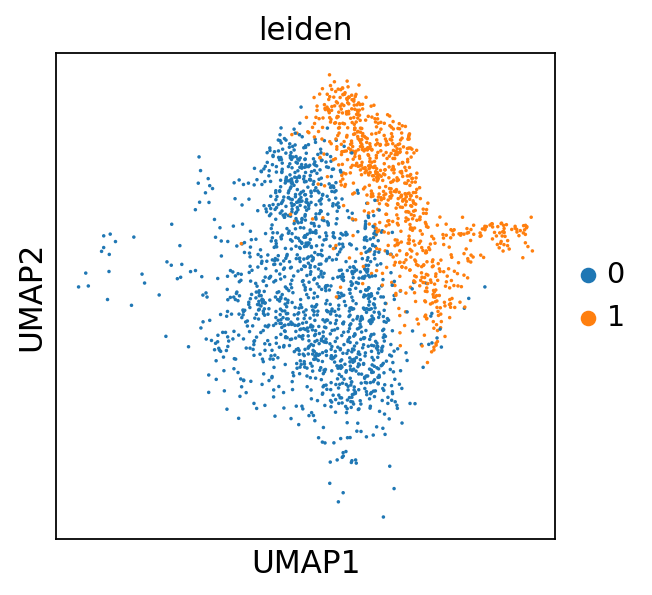

In [26]:
sc.tl.leiden(sub_concat['14'], resolution=0.15, random_state=0) # subcluster them using Leiden
groupings = [[0, 2],
             ]
nr.regroup(sub_concat['14'], groupings=groupings)
sc.pl.umap(sub_concat['14'], color='leiden', size=10)

running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


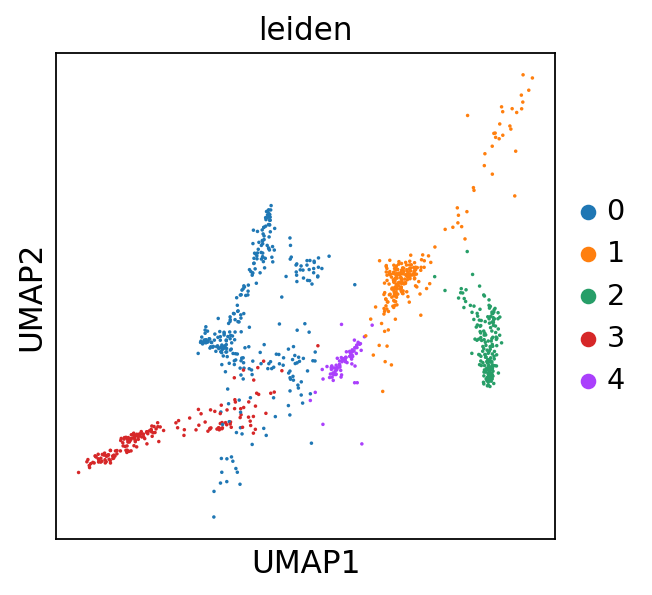

In [27]:
sc.tl.leiden(sub_concat['15'], resolution=0.15, random_state=0) # subcluster them using Leiden
sc.pl.umap(sub_concat['15'], color='leiden', size=10)

In [28]:
concat = nr.subcluster_mapper(concat, sub_concat)

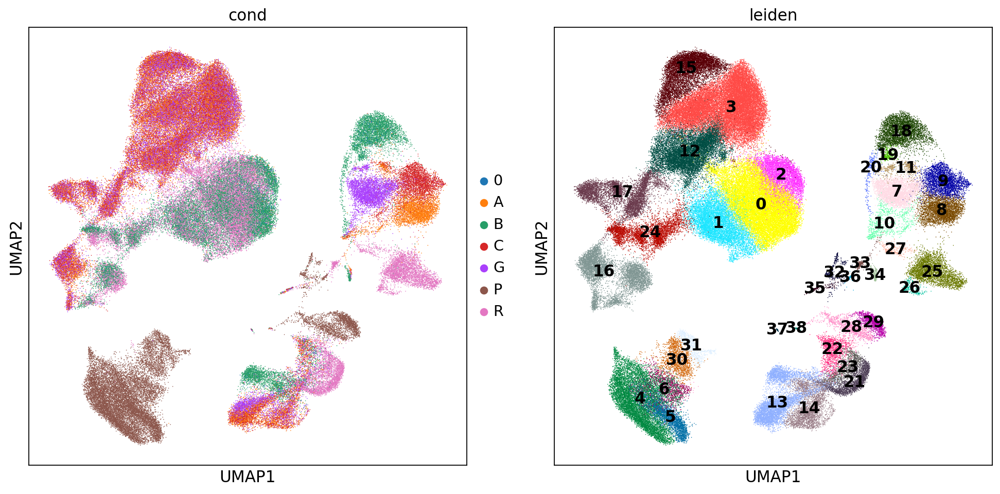

In [30]:
fig, ax = plt.subplots(1, 2, figsize=(15,7))
for color, ax, loc in zip(['cond', 'leiden'], ax, ['right margin', 'on data']):
    sc.pl.umap(concat,color=color, ax=ax, show=False, return_fig=False, size=2, legend_loc=loc)

... storing 'leiden' as categorical


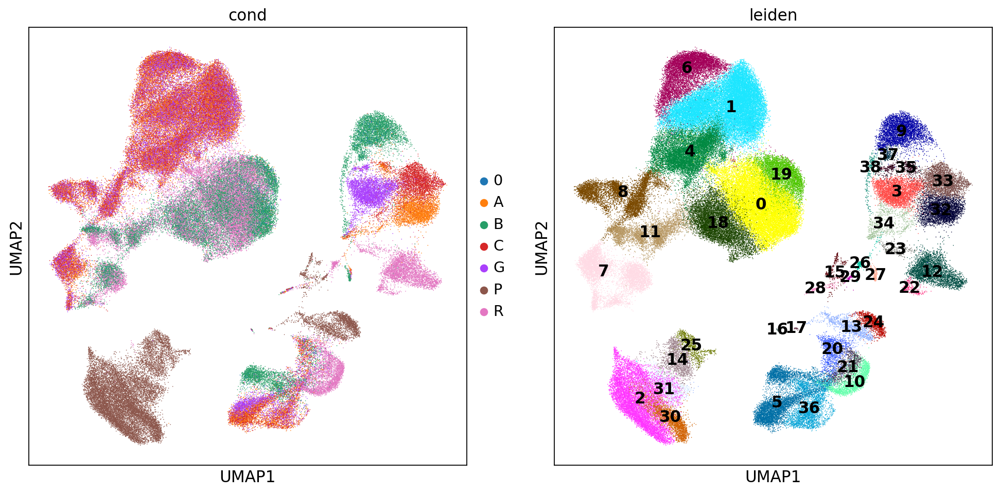

In [29]:
fig, ax = plt.subplots(1, 2, figsize=(15,7))
for color, ax, loc in zip(['cond', 'leiden'], ax, ['right margin', 'on data']):
    sc.pl.umap(concat,color=color, ax=ax, show=False, return_fig=False, size=2, legend_loc=loc)

0it [00:00, ?it/s]

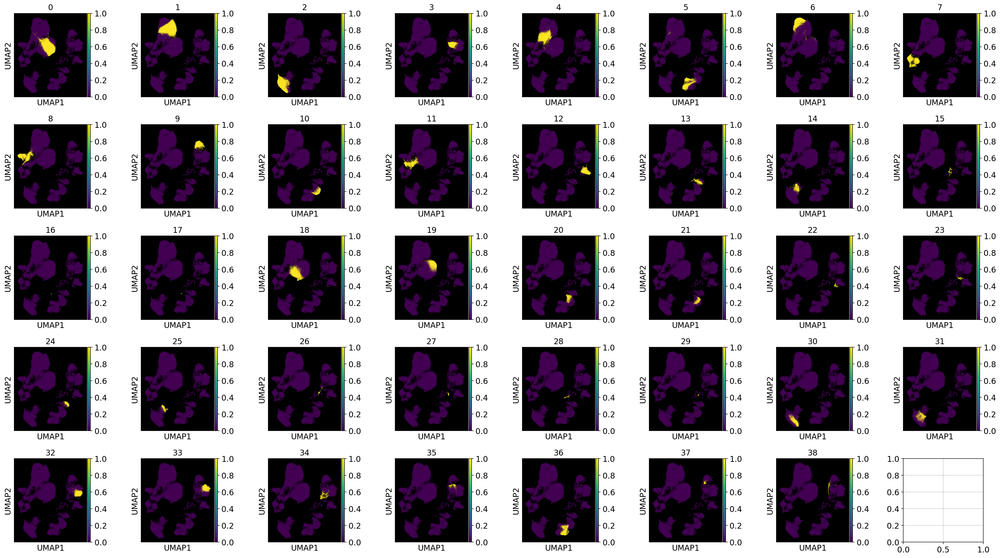

In [39]:
fig, ax = plt.subplots(5,8,figsize=(25,14))
for val, ax in tqdm(zip(concat.obs['leiden'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['leiden'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

# Regroup According to Cell Type

Here, I run the t test for differential expression of each cluster vs the rest to annotate the cell types.

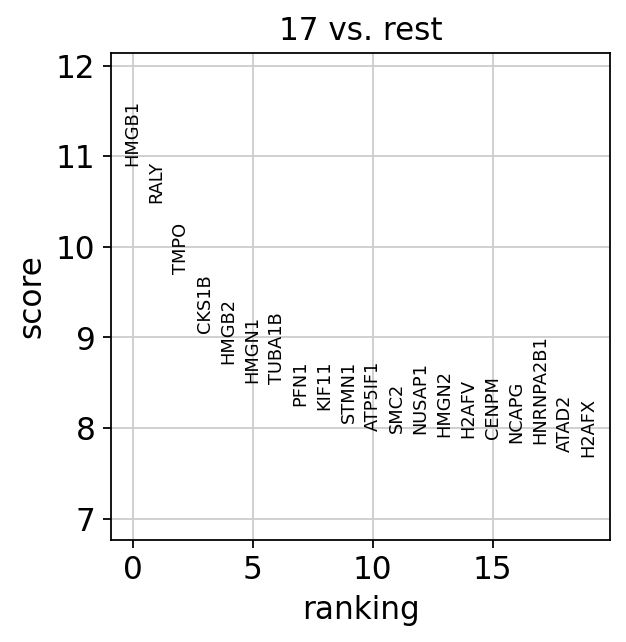

In [30]:
sc.settings.verbosity = 0 
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(concat, groupby='leiden', n_genes=50, method='t-test_overestim_var', groups=['17'])
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(concat, ncols=5, n_genes=20)
sc.settings.verbosity = 4

One of the groups I'm having trouble labeling is cluster 22, which, just based on proportions, looks like it is the non-classical monocytes of the R848 condition, but is not expressing CD16 (FCGR3A). I will label it as such now but I should evaluate later based on expression of other markers.

In [36]:
ctdict = dict()
ctdict['T'] = [0, 2, 1, 3, 4, 5, 6, 12, 15, 17, 24, 30]
ctdict['Myeloid'] = [7, 8, 9, 10, 11, 18, 19, 20, 25, 26, 27, 32, 33, 34, 36]
ctdict['B'] = [13, 14, 21, 22, 23, 28, 29]
ctdict['NK'] = [16, 31]
ctdict['Plasma'] = [37]
ctdict['Mitotic'] = [38]
ctdict['HSC'] = [35]

concat.obs['ct0'] = concat.obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        concat.obs['ct0'].replace(str(clust), ct, regex=True, inplace=True)
concat.obs['ct0'] = concat.obs['ct0'].astype('category')

ctdict = dict()
ctdict['T4'] = [0, 1, 3, 4, 6, 12]
ctdict['Myeloid'] = [7, 8, 9, 10, 11, 18, 19, 20, 25, 26, 27, 32, 33, 34, 36]
ctdict['B'] = [13, 14, 21, 22, 23, 28, 29]
ctdict['T8_Naive'] = [2, 5, 15]
ctdict['NK'] = [16, 31]
ctdict['T_Tox'] = [17, 24, 30]
ctdict['Plasma'] = [37]
ctdict['Mitotic'] = [38]
ctdict['HSC'] = [35]

concat.obs['ct1'] = concat.obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        concat.obs['ct1'].replace(str(clust), ct, regex=True, inplace=True)
concat.obs['ct1'] = concat.obs['ct1'].astype('category')

ctdict = dict()
ctdict['T4_Naive'] = [0, 3, 4]
ctdict['cM'] = [ 7, 8, 9, 18, 25]
ctdict['T4_EM'] = [1, 6, 12]
ctdict['B_Naive'] = [13, 21, 29]
ctdict['T8_Naive'] = [2, 5, 15]
ctdict['NK'] = [16, 31]
ctdict['T_Tox'] = [17, 24, 30]
ctdict['B_Mem'] = [14, 22, 23, 28]
ctdict['cDC'] = [10, 20, 27]
ctdict['pDC'] = [33, 34, 36]
ctdict['ncM'] = [11, 19, 26]
ctdict['Mye_PMAI'] = [32]
ctdict['Plasma'] = [37]
ctdict['Mitotic'] = [38]
ctdict['HSC'] = [35]

concat.obs['ct2'] = concat.obs['leiden']
for ct in ctdict:
    for clust in ctdict[ ct]:
        concat.obs['ct2'].replace(str(clust), ct, regex=True, inplace=True)
concat.obs['ct2'] = concat.obs['ct2'].astype('category')

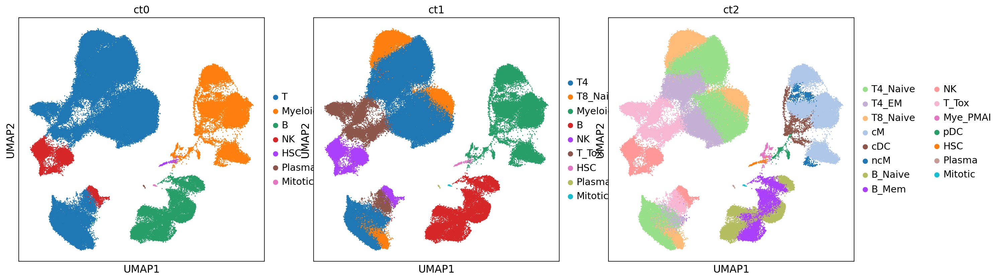

In [37]:
fig, ax = plt.subplots(1, 3, figsize=(20,6))
for color, ax in zip(['ct0', 'ct1', 'ct2'], np.ravel(ax)):
    sc.pl.umap(concat, color=color, ax=ax, show=False, return_fig=False, size=8)

0it [00:00, ?it/s]

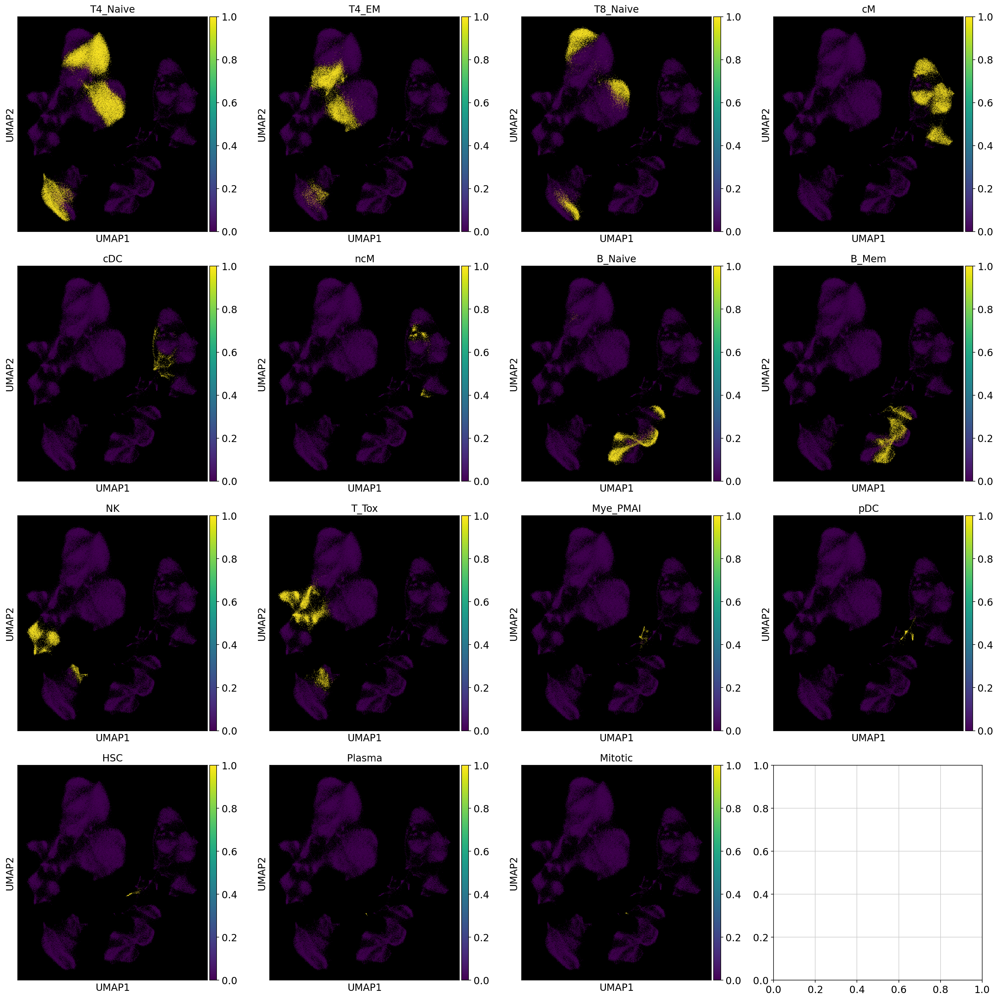

In [38]:
fig, ax = plt.subplots(4,4,figsize=(20,20))
for val, ax in tqdm(zip(concat.obs['ct2'].dtype.categories, np.ravel(ax))):
    concat.obs['val'] = concat.obs['ct2'] == val
    ax.set_facecolor('black')
    sc.pl.umap(concat,color='val', ax=ax, show=False, return_fig=False, title=val)
    concat.obs.drop(columns='val', inplace=True)
plt.tight_layout()

# Export

In [5]:
path = prefix_comb + 'h5ads/concat_3.h5ad'

# concat.write_h5ad(path)
concat = sc.read_h5ad(path)

# Adjust `concat`

Now that dim reduction is done and we've run combat, clustered and visualized the cells, we don't need the dense, high precision data matrix. Therefore, I will run `adjust_adata` which stores the important attributes of the `concat` object, then reloads the original matrix so that we can get back those genes we dropped, and then runs the simple transformations (`normalize_total`, `log1p`). 

In [7]:
concat = Octavia.adjust_adata(concat)

normalizing counts per cell
    finished (0:00:01)
normalizing counts per cell
    finished (0:00:00)


In [10]:
concat

AnnData object with n_obs × n_vars = 136142 × 20699
    obs: 'DROPLET.TYPE', 'NUM.READS', 'NUM.SNPS', 'batch', 'cond', 'exp_id', 'free_id', 'n_counts', 'percent_mito', 'pool_code', 'viability_eq_ctrl', 'viability_sample', 'mrna_n_counts', 'leiden', 'adts_n_counts', 'ct0', 'ct1', 'ct2'
    var: 'gene_ids', 'feature_types', 'genome', 'n_counts-0', 'n_counts-1', 'n_counts-10', 'n_counts-11', 'n_counts-2', 'n_counts-3', 'n_counts-4', 'n_counts-5', 'n_counts-6', 'n_counts-7', 'n_counts-8', 'n_counts-9', 'adts_n_counts', 'batch'
    uns: 'cond_colors', 'ct0_colors', 'ct1_colors', 'ct2_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [11]:
path = prefix_comb + 'h5ads/concat_4.h5ad'
# concat.write_h5ad(path)

... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


In [12]:
concat.obs.to_csv(prefix_comb + 'vals/concat_4_obs.csv')

In [8]:
path = prefix_comb + 'h5ads/concat_4.h5ad'
concat = sc.read_h5ad(path)

# Add Subtype Labels

At this point, I run `subcluster.ipynb` to subcluster the T cells, NK cells, and cDCs. I read in the labels here and add them as `ct3`.

In [13]:
subtype_labels = pd.read_csv(prefix_comb + 'vals/subtype_labels.csv', index_col=0).rename(columns={'leiden':'ct3'})

In [14]:
ct3 = concat.obs['ct2'].astype(str).copy()

In [15]:
for bc, label in tqdm(subtype_labels.iterrows()):
    ct3.loc[bc] = label.loc['ct3'] # pretty slow but it's not too many bcs

0it [00:00, ?it/s]

In [16]:
concat.obs['ct3'] = ct3.astype('category')

Trying to set attribute `._uns` of view, copying.


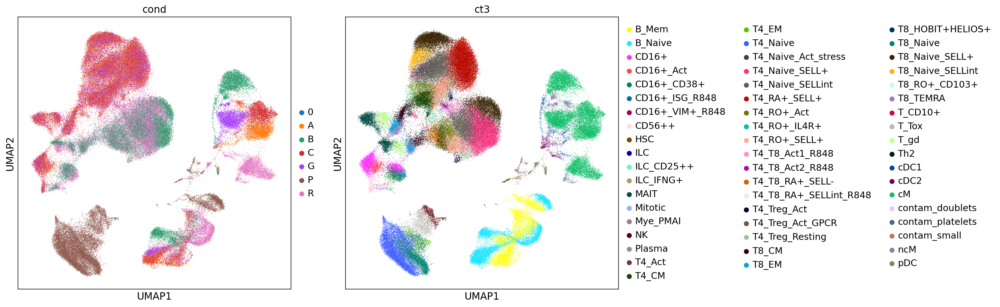

In [17]:
fig, ax = plt.subplots(1, 2, figsize=(15,7))
for color, ax, loc in zip(['cond', 'ct3'], ax, ['right margin', 'right margin']):
    sc.pl.umap(concat[concat.obs.sample(frac=1).index], color=color, ax=ax, show=False, return_fig=False, size=2, legend_loc=loc)

# Regroup

For the eQTL analysis, we group the cells according to broader categories to have sufficient numbers per group and increase power. To do this, we combine the cytotoxic T cells (namely the memory subtypes, gamma delta T cells, and MAIT cells) with the NK cells on the basis of cytotoxicity. We are considering **not** doing this, so if we decide not to, should delete this and re-export.

In [18]:
mapper = {
    'T_Tox': 'NK_T_Tox',
    'NK': 'NK_T_Tox'
}

In [19]:
concat.obs['ct5'] = concat.obs['ct1'].replace(mapper)

In [20]:
path = prefix_comb + 'h5ads/concat_5.h5ad'
# concat.write_h5ad(path)

... storing 'ct5' as categorical


In [21]:
concat.obs.to_csv(prefix_comb + 'vals/concat_5_obs.csv')

In [13]:
path = prefix_comb + 'h5ads/concat_5.h5ad'
concat = sc.read_h5ad(path)